In [24]:
# If using Colab, first clone your repo:
!git clone https://github.com/anmol2410/conversational-image-chatbot.git
%cd conversational-image-chatbot

# Add src/ folder to Python path
import sys
sys.path.append('/content/conversational-image-chatbot/src')


Cloning into 'conversational-image-chatbot'...
remote: Enumerating objects: 17, done.
remote: Counting objects: 100% (17/17), done.
remote: Compressing objects: 100% (13/13), done.
remote: Total 17 (delta 1), reused 17 (delta 1), pack-reused 0 (from 0)
Receiving objects: 100% (17/17), done.
Resolving deltas: 100% (1/1), done.
/content/conversational-image-chatbot


In [25]:
!pip install ultralytics


In [26]:
from ultralytics import YOLO

# Load a small pretrained YOLOv8 model
model = YOLO('yolov8n.pt')   # n = nano (fastest, smaller model)


In [30]:
from google.colab import files
uploaded = files.upload()   # select a file from your computer



Saving dog.jpg to dog.jpg



image 1/1 /content/conversational-image-chatbot/dog.jpg: 448x640 1 dog, 45.5ms
Speed: 3.0ms preprocess, 45.5ms inference, 1.8ms postprocess per image at shape (1, 3, 448, 640)


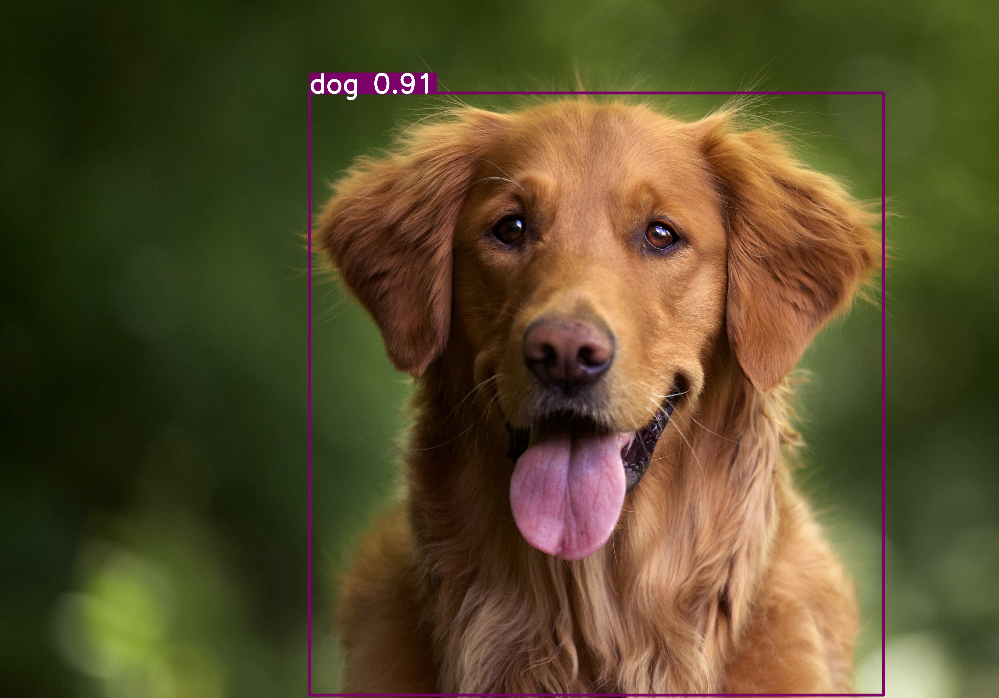

In [31]:
# Example: detect objects in dog.jpg
results = model('dog.jpg')

# Visualize the result (YOLO automatically saves an annotated copy)
results[0].show()


In [32]:
labels = []
for r in results:
    for box in r.boxes:
        cls = int(box.cls.cpu().numpy())   # class ID
        labels.append(model.names[cls])    # convert ID to name

print("Detected objects:", labels)


Detected objects: ['dog']


/tmp/ipython-input-2734254051.py:4: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cls = int(box.cls.cpu().numpy())   # class ID


In [33]:
def detect_objects(image_path):
    model = YOLO('yolov8n.pt')
    results = model(image_path)
    labels = []
    for r in results:
        for box in r.boxes:
            cls = int(box.cls.cpu().numpy())
            labels.append(model.names[cls])
    return labels

print(detect_objects('dog.jpg'))



image 1/1 /content/conversational-image-chatbot/dog.jpg: 448x640 1 dog, 7.0ms
Speed: 2.8ms preprocess, 7.0ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)
['dog']


/tmp/ipython-input-2346093474.py:7: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cls = int(box.cls.cpu().numpy())


In [35]:
from ultralytics import YOLO

# Load YOLO only once
model = YOLO('yolov8n.pt')

def detect_objects(image_path):
    """
    Detect objects in an image and return list of labels.
    """
    results = model(image_path)
    labels = []
    for r in results:
        for box in r.boxes:
            cls = int(box.cls.cpu().numpy())   # class ID
            labels.append(model.names[cls])    # convert to name
    return labels

# Test it
print(detect_objects("dog.jpg"))




image 1/1 /content/conversational-image-chatbot/dog.jpg: 448x640 1 dog, 7.1ms
Speed: 2.9ms preprocess, 7.1ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
['dog']


/tmp/ipython-input-448596772.py:14: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cls = int(box.cls.cpu().numpy())   # class ID
